# CNN 遥感图像分类项目

## 数据说明
This is a 21 class land use image dataset meant for research purposes. 
There are 100 images for each of the following classes:
+ agricultural
+ airplane
+ baseballdiamond
+ beach
+ buildings
+ chaparral
+ denseresidential
+ forest
+ freeway
+ golfcourse
+ harbor
+ intersection
+ mediumresidential
+ mobilehomepark
+ overpass
+ parkinglot
+ river
+ runway
+ sparseresidential
+ storagetanks
+ tenniscourt

Each image measures 256x256 pixels.

The images were manually extracted from large images from the USGS National Map Urban Area Imagery collection for various urban areas around the country. The pixel resolution of this public domain imagery is 1 foot.

Download site: http://weegee.vision.ucmerced.edu/datasets/landuse.html

# 1. 读取原始数据和文件

## Import Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pickle

from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import train_test_split

from tensorflow import keras
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.layers import Input, Dense, Conv2D, MaxPooling2D
from tensorflow.keras.layers import GlobalAveragePooling2D, AveragePooling2D
from tensorflow.keras.layers import ZeroPadding2D, Dropout, Flatten, add, Reshape
from tensorflow.keras.layers import Activation, BatchNormalization
from tensorflow.keras.optimizers import Adam, SGD
from tensorflow.keras.utils import plot_model,to_categorical
from tensorflow.keras import backend as K
from tensorflow.keras import initializers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

from skimage.transform import resize
import cv2

from PIL import Image
import os
from shutil import copyfile

In [2]:
#!pip freeze 

In [3]:
print(keras.__version__)

2.4.0


In [4]:
category_names = [
'agricultural',
    'airplane', 'baseballdiamond', 'beach', 
    'buildings', 'chaparral', 'denseresidential', 'forest', 
    'freeway', 'golfcourse', 'harbor', 'intersection', 
    'mediumresidential', 'mobilehomepark', 
    'overpass', 'parkinglot', 'river', 'runway', 
    'sparseresidential', 'storagetanks', 'tenniscourt'
]

In [5]:
num_images = 100  # per category
nb_classes = len(category_names)
patch_size = 256  # width and height in pixel
channels = 3

In [6]:
# Load the numpy datasets
images_orig = np.load('data/UCMerced_images_orig_MultiClass21.npy')
labels_num = np.load('data/UCMerced_labels_num_MultiClass21.npy')

# Convert labels to categorical 'one hot encoded vector' --> required format for softmax cross-entropy loss.
# Create an array of zeros with length nb_classes and put a 1 at the index of the true label.
labels = to_categorical(labels_num, nb_classes)

print('Orginal Labels: \n')
for i in range(1,(nb_classes)*100+1, 100):
    print(labels_num[i])

print('One-hot encoded Labels: \n')
for i in range(1,(nb_classes)*100+1, 100):
    print(labels[i])

print('\nImages shape: {}'.format(images_orig.shape))
print('\nLabel shape: {}'.format(labels.shape))

Orginal Labels: 

[0]
[1]
[2]
[3]
[4]
[5]
[6]
[7]
[8]
[9]
[10]
[11]
[12]
[13]
[14]
[15]
[16]
[17]
[18]
[19]
[20]
One-hot encoded Labels: 

[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 

# 2. Split train, val and test

In [7]:
nb_images = images_orig.shape[0]
nb_images

2100

In [8]:
X_train, X_test, y_train, y_test = train_test_split(images_orig, labels, 
                                                    test_size=0.2, 
                                                    stratify = labels, 
                                                    random_state=2021)

X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, 
                                                  test_size=0.25, 
                                                  stratify = y_train,
                                                  random_state=2021) 

# 0.25 x 0.8 = 0.2

In [9]:
print(X_train.shape,X_val.shape,X_test.shape,y_train.shape,y_val.shape,y_test.shape,)

(1260, 64, 64, 3) (420, 64, 64, 3) (420, 64, 64, 3) (1260, 21) (420, 21) (420, 21)


Check how many images per class in train/val/test

In [10]:
def unique_counts(arr):
    unique, counts = np.unique(arr, axis=0, return_counts=True)
    unique_num = [np.where(r==1)[0][0] for r in unique] 
    print(dict(zip(unique_num, counts)))

In [11]:
unique_counts(y_train)
unique_counts(y_val)
unique_counts(y_test)

{20: 60, 19: 60, 18: 60, 17: 60, 16: 60, 15: 60, 14: 60, 13: 60, 12: 60, 11: 60, 10: 60, 9: 60, 8: 60, 7: 60, 6: 60, 5: 60, 4: 60, 3: 60, 2: 60, 1: 60, 0: 60}
{20: 20, 19: 20, 18: 20, 17: 20, 16: 20, 15: 20, 14: 20, 13: 20, 12: 20, 11: 20, 10: 20, 9: 20, 8: 20, 7: 20, 6: 20, 5: 20, 4: 20, 3: 20, 2: 20, 1: 20, 0: 20}
{20: 20, 19: 20, 18: 20, 17: 20, 16: 20, 15: 20, 14: 20, 13: 20, 12: 20, 11: 20, 10: 20, 9: 20, 8: 20, 7: 20, 6: 20, 5: 20, 4: 20, 3: 20, 2: 20, 1: 20, 0: 20}


# 3. Build CNN Base Model 

**Task**: Implement the following convolutional neural network (CNN). Consider the information in the Figure as well as the additional remarks:

* Use `strides = (1, 1)` for all convolutional layers. 
* Use `padding='same'` to pad the inputs and preserve the spatial dimensions after the convolution.
* Use 'relu' as activation for both conv and dense layers, except the last layer that should output 'softmax' or 'sigmoid' activations (pseudo class probabilities).
* The spatial extent is reduced by using max pooling with `pool_size = (3, 3)`. Set the parameter `strides`, such that the spatial extent is reduced by factor 2 in both spatial dimensions.
* Add a dropout layer with `prob_drop_hidden = 0.5` after the first dense layer.

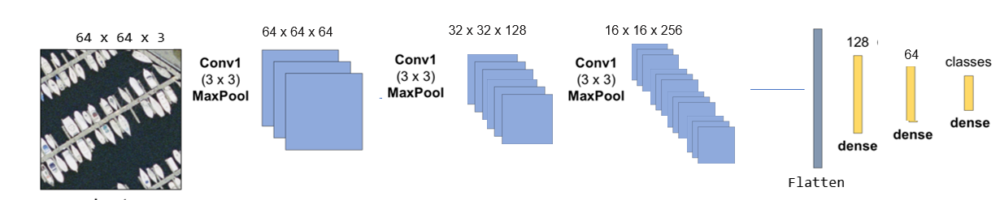

**Questions**:
1. What is the shape of a single filter kernel in the convolutional layer?
2. What is the shape of the output feature maps after the convolutional layer (before the MaxPooling)?
3. `model.summary()` shows the dimension of each layer output. What is the first dimension (None) of the output shape?

In [12]:
# parameters:
input_shape = (int(patch_size/4), int(patch_size/4), channels)
pool_size = (3, 3)                  # size of pooling area for max pooling
prob_drop_hidden = 0.5              # drop probability for dropout @ dense layer

def define_CNN_base():

    model = Sequential()

    # conv1 layer
    model.add(Conv2D(filters=64, kernel_size=(3, 3), strides=(1,1), padding='same', activation='relu', 
                   input_shape=input_shape))    
    model.add(Conv2D(filters=128, kernel_size=(3, 3), strides=(1,1), padding='same', activation='relu', ))    
    model.add(MaxPooling2D(pool_size=pool_size, strides=(2, 2), padding='same'))
    
    # conv2 layer
    model.add(Conv2D(filters=128, kernel_size=(3, 3), strides=(1,1), padding='same', activation='relu' ))
    model.add(Conv2D(filters=256, kernel_size=(3, 3), strides=(1,1), padding='same', activation='relu' ))
    model.add(MaxPooling2D(pool_size=pool_size, strides=(2,2), padding='same'))

    model.add(Flatten())

    # fc1 layer
    model.add(Dense(256, activation='relu'))
    model.add(Dropout(rate=prob_drop_hidden))

    # fc2 layer
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(rate=prob_drop_hidden))

    # The output of the model (softmax)
    model.add(Dense(nb_classes, activation='softmax'))
    #model.add(Dense(nb_classes, activation='sigmoid'))

    return model

# clear the session first, such that layer names start with index 1
K.clear_session()
model_CNN_base = define_CNN_base()
model_CNN_base.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 64, 64, 64)        1792      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 32, 32, 128)       147584    
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 32, 32, 256)       295168    
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 16, 16, 256)       0         
_________________________________________________________________
flatten (Flatten)            (None, 65536)             0

# 4. Train the base model

In [13]:
# Set hyper parameters
epochs = 1000
base_learning_rate=0.001
batch_size = 32

In [14]:
# Calculate the number of batches per epoch. 
# One epoch is defined as an update pass through the full training data. 
# One iteration is defined as an update through one mini-batch.
batches_per_epoch = y_train.shape[0]//batch_size
# the number of batches to see the full validation data:
validation_steps = y_val.shape[0]//batch_size
print('number of images per batch: {}'.format(batch_size))
print('batches per epoch: {}'.format(batches_per_epoch))
print('validation steps: {}'.format(validation_steps))

number of images per batch: 32
batches per epoch: 39
validation steps: 13


### Data augmentation

In [15]:
# Data Generator provided by keras to load the training data in batches
image_gen = ImageDataGenerator(
    #zoom_range = 0.1,
    width_shift_range=5,   # pixel
    height_shift_range=5,  # pixel
    horizontal_flip=True,
    vertical_flip=True,
    rotation_range=20)

# At Test/Validation time without data augmentation
image_gen_test = ImageDataGenerator()

Total Images: 9


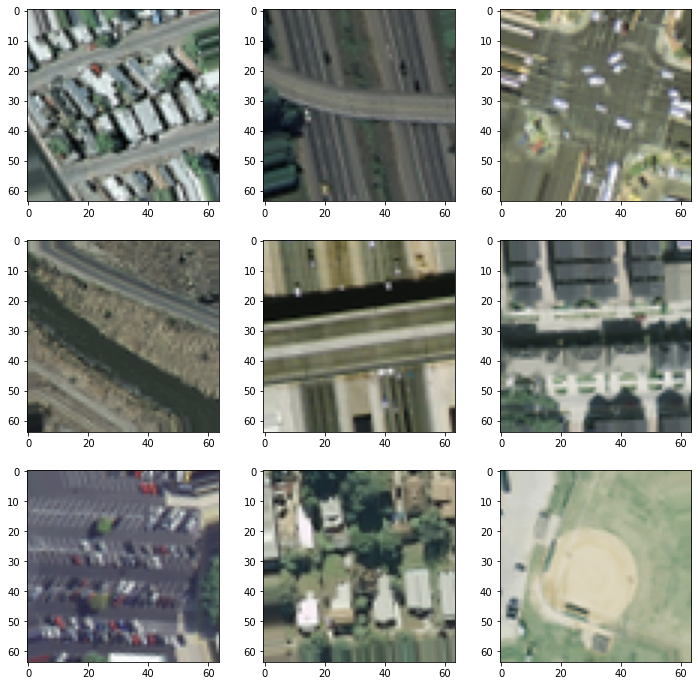

In [16]:
plt.figure(figsize=(12,12))
# configure batch size and retrieve one batch of images
for X_batch, y_batch in image_gen.flow(X_train, y_train, batch_size=9):
	# create a grid of 3x3 images
	print('Total Images:', len(X_batch))
	for i in range(0, 9):
		plt.subplot(330 + 1 + i)
		plt.imshow(X_batch[i].reshape(64, 64,3))
	# show the plot
	plt.show()
	break
    

In [17]:
train_gen = image_gen.flow(np.array(X_train),
                           y_train,
                           batch_size = batch_size,
                           shuffle = True)
val_gen = image_gen_test.flow(np.array(X_val),
                              y_val,
                              batch_size = batch_size,
                              shuffle = True)


In [18]:
# set your architecture
model = define_CNN_base()

Compile the model with loss and the Adam optimizer.

In [19]:
# Define an optimizer
opt = Adam(lr=base_learning_rate)

model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])    

In [20]:
checkpoint_best_model = 'model/MultiClass_3Conv2Den_dataAugm.hdf5'
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=600)
mc = ModelCheckpoint(checkpoint_best_model, monitor='val_accuracy', mode='max', verbose=1, save_best_only=True)

Training commences by making a call to the fit method with our training and validation sets

In [21]:
# Fit the model parameters
print('training...')

history = model.fit(
                x=train_gen,
                steps_per_epoch=batches_per_epoch, 
                epochs=epochs, 
                validation_data=val_gen,
                validation_steps=validation_steps,
                callbacks=[es, mc],
                verbose = 2,
                )

print('done')

training...
Epoch 1/1000

Epoch 00001: val_accuracy improved from -inf to 0.07452, saving model to model\MultiClass_3Conv2Den_dataAugm.hdf5
39/39 - 55s - loss: 3.0974 - accuracy: 0.0432 - val_loss: 3.0431 - val_accuracy: 0.0745
Epoch 2/1000

Epoch 00002: val_accuracy improved from 0.07452 to 0.07933, saving model to model\MultiClass_3Conv2Den_dataAugm.hdf5
39/39 - 53s - loss: 3.0342 - accuracy: 0.0562 - val_loss: 2.9522 - val_accuracy: 0.0793
Epoch 3/1000

Epoch 00003: val_accuracy did not improve from 0.07933
39/39 - 52s - loss: 2.9869 - accuracy: 0.0619 - val_loss: 2.8683 - val_accuracy: 0.0769
Epoch 4/1000

Epoch 00004: val_accuracy improved from 0.07933 to 0.12260, saving model to model\MultiClass_3Conv2Den_dataAugm.hdf5
39/39 - 53s - loss: 2.9052 - accuracy: 0.0985 - val_loss: 2.7439 - val_accuracy: 0.1226
Epoch 5/1000

Epoch 00005: val_accuracy improved from 0.12260 to 0.14423, saving model to model\MultiClass_3Conv2Den_dataAugm.hdf5
39/39 - 53s - loss: 2.7854 - accuracy: 0.1246 

Epoch 44/1000

Epoch 00044: val_accuracy did not improve from 0.71154
39/39 - 53s - loss: 1.0407 - accuracy: 0.6393 - val_loss: 0.9026 - val_accuracy: 0.6899
Epoch 45/1000

Epoch 00045: val_accuracy improved from 0.71154 to 0.73798, saving model to model\MultiClass_3Conv2Den_dataAugm.hdf5
39/39 - 54s - loss: 0.9717 - accuracy: 0.6726 - val_loss: 0.8214 - val_accuracy: 0.7380
Epoch 46/1000

Epoch 00046: val_accuracy did not improve from 0.73798
39/39 - 53s - loss: 0.8841 - accuracy: 0.7125 - val_loss: 0.8463 - val_accuracy: 0.7067
Epoch 47/1000

Epoch 00047: val_accuracy did not improve from 0.73798
39/39 - 53s - loss: 0.9924 - accuracy: 0.6726 - val_loss: 0.8614 - val_accuracy: 0.7308
Epoch 48/1000

Epoch 00048: val_accuracy did not improve from 0.73798
39/39 - 52s - loss: 0.9915 - accuracy: 0.6718 - val_loss: 0.8213 - val_accuracy: 0.7308
Epoch 49/1000

Epoch 00049: val_accuracy did not improve from 0.73798
39/39 - 52s - loss: 0.8939 - accuracy: 0.7207 - val_loss: 0.8430 - val_accurac

Epoch 94/1000

Epoch 00094: val_accuracy improved from 0.84375 to 0.84615, saving model to model\MultiClass_3Conv2Den_dataAugm.hdf5
39/39 - 53s - loss: 0.6097 - accuracy: 0.8046 - val_loss: 0.4688 - val_accuracy: 0.8462
Epoch 95/1000

Epoch 00095: val_accuracy did not improve from 0.84615
39/39 - 54s - loss: 0.4958 - accuracy: 0.8306 - val_loss: 0.5162 - val_accuracy: 0.8413
Epoch 96/1000

Epoch 00096: val_accuracy did not improve from 0.84615
39/39 - 54s - loss: 0.5253 - accuracy: 0.8298 - val_loss: 0.5028 - val_accuracy: 0.8365
Epoch 97/1000

Epoch 00097: val_accuracy did not improve from 0.84615
39/39 - 54s - loss: 0.5125 - accuracy: 0.8325 - val_loss: 0.4814 - val_accuracy: 0.8413
Epoch 98/1000

Epoch 00098: val_accuracy did not improve from 0.84615
39/39 - 55s - loss: 0.5152 - accuracy: 0.8373 - val_loss: 0.5292 - val_accuracy: 0.8245
Epoch 99/1000

Epoch 00099: val_accuracy did not improve from 0.84615
39/39 - 53s - loss: 0.5199 - accuracy: 0.8184 - val_loss: 0.4661 - val_accurac

Epoch 144/1000

Epoch 00144: val_accuracy did not improve from 0.87260
39/39 - 53s - loss: 0.3513 - accuracy: 0.8917 - val_loss: 0.4724 - val_accuracy: 0.8654
Epoch 145/1000

Epoch 00145: val_accuracy did not improve from 0.87260
39/39 - 52s - loss: 0.5129 - accuracy: 0.8445 - val_loss: 0.8150 - val_accuracy: 0.7740
Epoch 146/1000

Epoch 00146: val_accuracy did not improve from 0.87260
39/39 - 53s - loss: 0.4532 - accuracy: 0.8640 - val_loss: 0.4562 - val_accuracy: 0.8606
Epoch 147/1000

Epoch 00147: val_accuracy did not improve from 0.87260
39/39 - 53s - loss: 0.3852 - accuracy: 0.8730 - val_loss: 0.4576 - val_accuracy: 0.8413
Epoch 148/1000

Epoch 00148: val_accuracy did not improve from 0.87260
39/39 - 53s - loss: 0.3167 - accuracy: 0.9015 - val_loss: 0.5824 - val_accuracy: 0.8317
Epoch 149/1000

Epoch 00149: val_accuracy improved from 0.87260 to 0.90144, saving model to model\MultiClass_3Conv2Den_dataAugm.hdf5
39/39 - 54s - loss: 0.3732 - accuracy: 0.8827 - val_loss: 0.3698 - val_a

Epoch 196/1000

Epoch 00196: val_accuracy did not improve from 0.90144
39/39 - 46s - loss: 0.2780 - accuracy: 0.8966 - val_loss: 0.6080 - val_accuracy: 0.8438
Epoch 197/1000

Epoch 00197: val_accuracy did not improve from 0.90144
39/39 - 52s - loss: 0.3449 - accuracy: 0.8950 - val_loss: 0.4292 - val_accuracy: 0.8750
Epoch 198/1000

Epoch 00198: val_accuracy did not improve from 0.90144
39/39 - 56s - loss: 0.3162 - accuracy: 0.8966 - val_loss: 0.6762 - val_accuracy: 0.8029
Epoch 199/1000

Epoch 00199: val_accuracy did not improve from 0.90144
39/39 - 56s - loss: 0.3292 - accuracy: 0.8884 - val_loss: 0.4617 - val_accuracy: 0.8678
Epoch 200/1000

Epoch 00200: val_accuracy did not improve from 0.90144
39/39 - 57s - loss: 0.3106 - accuracy: 0.9080 - val_loss: 0.4156 - val_accuracy: 0.8798
Epoch 201/1000

Epoch 00201: val_accuracy did not improve from 0.90144
39/39 - 57s - loss: 0.3234 - accuracy: 0.9030 - val_loss: 0.3843 - val_accuracy: 0.8870
Epoch 202/1000

Epoch 00202: val_accuracy did 

Epoch 248/1000

Epoch 00248: val_accuracy did not improve from 0.90144
39/39 - 50s - loss: 0.3943 - accuracy: 0.8819 - val_loss: 0.6665 - val_accuracy: 0.8389
Epoch 249/1000

Epoch 00249: val_accuracy did not improve from 0.90144
39/39 - 50s - loss: 0.2502 - accuracy: 0.9121 - val_loss: 0.4520 - val_accuracy: 0.8774
Epoch 250/1000

Epoch 00250: val_accuracy did not improve from 0.90144
39/39 - 50s - loss: 0.2182 - accuracy: 0.9292 - val_loss: 0.5123 - val_accuracy: 0.8534
Epoch 251/1000

Epoch 00251: val_accuracy did not improve from 0.90144
39/39 - 51s - loss: 0.2085 - accuracy: 0.9292 - val_loss: 0.3771 - val_accuracy: 0.8870
Epoch 252/1000

Epoch 00252: val_accuracy did not improve from 0.90144
39/39 - 56s - loss: 0.2655 - accuracy: 0.9243 - val_loss: 0.5536 - val_accuracy: 0.8558
Epoch 253/1000

Epoch 00253: val_accuracy did not improve from 0.90144
39/39 - 53s - loss: 0.2516 - accuracy: 0.9275 - val_loss: 0.5833 - val_accuracy: 0.8462
Epoch 254/1000

Epoch 00254: val_accuracy did 

Epoch 300/1000

Epoch 00300: val_accuracy did not improve from 0.90144
39/39 - 49s - loss: 0.1964 - accuracy: 0.9373 - val_loss: 0.5919 - val_accuracy: 0.8774
Epoch 301/1000

Epoch 00301: val_accuracy did not improve from 0.90144
39/39 - 49s - loss: 0.2100 - accuracy: 0.9292 - val_loss: 0.6093 - val_accuracy: 0.8774
Epoch 302/1000

Epoch 00302: val_accuracy did not improve from 0.90144
39/39 - 50s - loss: 0.2987 - accuracy: 0.9191 - val_loss: 0.6821 - val_accuracy: 0.8293
Epoch 303/1000

Epoch 00303: val_accuracy did not improve from 0.90144
39/39 - 49s - loss: 0.2698 - accuracy: 0.9235 - val_loss: 0.4748 - val_accuracy: 0.8774
Epoch 304/1000

Epoch 00304: val_accuracy did not improve from 0.90144
39/39 - 49s - loss: 0.2365 - accuracy: 0.9300 - val_loss: 0.5469 - val_accuracy: 0.8702
Epoch 305/1000

Epoch 00305: val_accuracy did not improve from 0.90144
39/39 - 51s - loss: 0.2179 - accuracy: 0.9194 - val_loss: 0.6013 - val_accuracy: 0.8726
Epoch 306/1000

Epoch 00306: val_accuracy did 

Epoch 352/1000

Epoch 00352: val_accuracy did not improve from 0.90144
39/39 - 49s - loss: 0.1580 - accuracy: 0.9471 - val_loss: 0.4958 - val_accuracy: 0.8894
Epoch 353/1000

Epoch 00353: val_accuracy did not improve from 0.90144
39/39 - 50s - loss: 0.1332 - accuracy: 0.9520 - val_loss: 0.5479 - val_accuracy: 0.8822
Epoch 354/1000

Epoch 00354: val_accuracy did not improve from 0.90144
39/39 - 49s - loss: 0.1825 - accuracy: 0.9389 - val_loss: 0.5414 - val_accuracy: 0.8942
Epoch 355/1000

Epoch 00355: val_accuracy improved from 0.90144 to 0.90385, saving model to model\MultiClass_3Conv2Den_dataAugm.hdf5
39/39 - 50s - loss: 0.1706 - accuracy: 0.9479 - val_loss: 0.4768 - val_accuracy: 0.9038
Epoch 356/1000

Epoch 00356: val_accuracy did not improve from 0.90385
39/39 - 49s - loss: 0.2059 - accuracy: 0.9365 - val_loss: 0.6219 - val_accuracy: 0.8630
Epoch 357/1000

Epoch 00357: val_accuracy did not improve from 0.90385
39/39 - 49s - loss: 0.1806 - accuracy: 0.9414 - val_loss: 0.6268 - val_a

Epoch 404/1000

Epoch 00404: val_accuracy did not improve from 0.90385
39/39 - 50s - loss: 0.2406 - accuracy: 0.9340 - val_loss: 0.5880 - val_accuracy: 0.8582
Epoch 405/1000

Epoch 00405: val_accuracy did not improve from 0.90385
39/39 - 49s - loss: 0.1889 - accuracy: 0.9373 - val_loss: 0.7239 - val_accuracy: 0.8486
Epoch 406/1000

Epoch 00406: val_accuracy did not improve from 0.90385
39/39 - 47s - loss: 0.1612 - accuracy: 0.9536 - val_loss: 0.5011 - val_accuracy: 0.8750
Epoch 407/1000

Epoch 00407: val_accuracy did not improve from 0.90385
39/39 - 38s - loss: 0.1876 - accuracy: 0.9438 - val_loss: 0.5663 - val_accuracy: 0.8606
Epoch 408/1000

Epoch 00408: val_accuracy did not improve from 0.90385
39/39 - 39s - loss: 0.2158 - accuracy: 0.9283 - val_loss: 0.7527 - val_accuracy: 0.8462
Epoch 409/1000

Epoch 00409: val_accuracy did not improve from 0.90385
39/39 - 40s - loss: 0.2374 - accuracy: 0.9357 - val_loss: 0.6446 - val_accuracy: 0.8462
Epoch 410/1000

Epoch 00410: val_accuracy did 

Epoch 456/1000

Epoch 00456: val_accuracy did not improve from 0.90865
39/39 - 49s - loss: 0.1523 - accuracy: 0.9617 - val_loss: 0.6275 - val_accuracy: 0.8678
Epoch 457/1000

Epoch 00457: val_accuracy did not improve from 0.90865
39/39 - 49s - loss: 0.1646 - accuracy: 0.9479 - val_loss: 0.7263 - val_accuracy: 0.8558
Epoch 458/1000

Epoch 00458: val_accuracy did not improve from 0.90865
39/39 - 49s - loss: 0.1963 - accuracy: 0.9454 - val_loss: 0.4894 - val_accuracy: 0.8966
Epoch 459/1000

Epoch 00459: val_accuracy did not improve from 0.90865
39/39 - 49s - loss: 0.2000 - accuracy: 0.9471 - val_loss: 0.5543 - val_accuracy: 0.8798
Epoch 460/1000

Epoch 00460: val_accuracy did not improve from 0.90865
39/39 - 49s - loss: 0.2206 - accuracy: 0.9381 - val_loss: 0.6943 - val_accuracy: 0.8582
Epoch 461/1000

Epoch 00461: val_accuracy did not improve from 0.90865
39/39 - 49s - loss: 0.2639 - accuracy: 0.9259 - val_loss: 0.5280 - val_accuracy: 0.8726
Epoch 462/1000

Epoch 00462: val_accuracy did 

Epoch 508/1000

Epoch 00508: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1543 - accuracy: 0.9446 - val_loss: 0.6406 - val_accuracy: 0.8750
Epoch 509/1000

Epoch 00509: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1059 - accuracy: 0.9607 - val_loss: 0.6175 - val_accuracy: 0.8654
Epoch 510/1000

Epoch 00510: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1342 - accuracy: 0.9634 - val_loss: 0.5848 - val_accuracy: 0.8942
Epoch 511/1000

Epoch 00511: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1526 - accuracy: 0.9544 - val_loss: 0.6449 - val_accuracy: 0.8870
Epoch 512/1000

Epoch 00512: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1929 - accuracy: 0.9479 - val_loss: 0.5809 - val_accuracy: 0.8774
Epoch 513/1000

Epoch 00513: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1766 - accuracy: 0.9503 - val_loss: 0.6330 - val_accuracy: 0.8558
Epoch 514/1000

Epoch 00514: val_accuracy did 

Epoch 560/1000

Epoch 00560: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1420 - accuracy: 0.9577 - val_loss: 0.6610 - val_accuracy: 0.8606
Epoch 561/1000

Epoch 00561: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1885 - accuracy: 0.9454 - val_loss: 0.6320 - val_accuracy: 0.8654
Epoch 562/1000

Epoch 00562: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1486 - accuracy: 0.9544 - val_loss: 0.6000 - val_accuracy: 0.8774
Epoch 563/1000

Epoch 00563: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1930 - accuracy: 0.9422 - val_loss: 0.6840 - val_accuracy: 0.8774
Epoch 564/1000

Epoch 00564: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1927 - accuracy: 0.9422 - val_loss: 0.7385 - val_accuracy: 0.8558
Epoch 565/1000

Epoch 00565: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1374 - accuracy: 0.9552 - val_loss: 0.5540 - val_accuracy: 0.8726
Epoch 566/1000

Epoch 00566: val_accuracy did 

Epoch 612/1000

Epoch 00612: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1296 - accuracy: 0.9568 - val_loss: 0.5679 - val_accuracy: 0.8918
Epoch 613/1000

Epoch 00613: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.0806 - accuracy: 0.9739 - val_loss: 0.4663 - val_accuracy: 0.8942
Epoch 614/1000

Epoch 00614: val_accuracy did not improve from 0.91346
39/39 - 50s - loss: 0.1653 - accuracy: 0.9544 - val_loss: 0.4741 - val_accuracy: 0.8966
Epoch 615/1000

Epoch 00615: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1204 - accuracy: 0.9585 - val_loss: 0.6540 - val_accuracy: 0.8582
Epoch 616/1000

Epoch 00616: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1036 - accuracy: 0.9691 - val_loss: 0.4714 - val_accuracy: 0.9062
Epoch 617/1000

Epoch 00617: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.0922 - accuracy: 0.9723 - val_loss: 0.5057 - val_accuracy: 0.8846
Epoch 618/1000

Epoch 00618: val_accuracy did 

Epoch 664/1000

Epoch 00664: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1743 - accuracy: 0.9552 - val_loss: 0.5403 - val_accuracy: 0.8870
Epoch 665/1000

Epoch 00665: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1157 - accuracy: 0.9609 - val_loss: 0.4973 - val_accuracy: 0.8822
Epoch 666/1000

Epoch 00666: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1216 - accuracy: 0.9609 - val_loss: 0.5739 - val_accuracy: 0.8966
Epoch 667/1000

Epoch 00667: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1960 - accuracy: 0.9454 - val_loss: 0.8965 - val_accuracy: 0.8341
Epoch 668/1000

Epoch 00668: val_accuracy did not improve from 0.91346
39/39 - 45s - loss: 0.1397 - accuracy: 0.9560 - val_loss: 0.5491 - val_accuracy: 0.8894
Epoch 669/1000

Epoch 00669: val_accuracy did not improve from 0.91346
39/39 - 45s - loss: 0.0776 - accuracy: 0.9707 - val_loss: 0.7150 - val_accuracy: 0.8798
Epoch 670/1000

Epoch 00670: val_accuracy did 

Epoch 716/1000

Epoch 00716: val_accuracy did not improve from 0.91346
39/39 - 49s - loss: 0.1323 - accuracy: 0.9617 - val_loss: 0.6713 - val_accuracy: 0.8822
Epoch 717/1000

Epoch 00717: val_accuracy did not improve from 0.91346
39/39 - 39s - loss: 0.1946 - accuracy: 0.9495 - val_loss: 0.6191 - val_accuracy: 0.8654
Epoch 718/1000

Epoch 00718: val_accuracy did not improve from 0.91346
39/39 - 39s - loss: 0.1435 - accuracy: 0.9634 - val_loss: 0.9739 - val_accuracy: 0.8438
Epoch 719/1000

Epoch 00719: val_accuracy did not improve from 0.91346
39/39 - 40s - loss: 0.1343 - accuracy: 0.9601 - val_loss: 0.6817 - val_accuracy: 0.8942
Epoch 720/1000

Epoch 00720: val_accuracy did not improve from 0.91346
39/39 - 41s - loss: 0.1141 - accuracy: 0.9674 - val_loss: 0.8031 - val_accuracy: 0.8486
Epoch 721/1000

Epoch 00721: val_accuracy did not improve from 0.91346
39/39 - 42s - loss: 0.1610 - accuracy: 0.9487 - val_loss: 0.6736 - val_accuracy: 0.8678
Epoch 722/1000

Epoch 00722: val_accuracy did 

In [22]:
def history_plot(model_id, history):
	plt.figure(figsize=(8,10)) 
	# plot loss
	plt.subplot(2, 1, 1)
	plt.title('Cross Entropy Loss - ' + model_id, fontsize = 12)
	plt.plot(history.history['loss'], color='blue', label='train')
	plt.plot(history.history['val_loss'], color='orange', label='val')
	plt.xlabel("Epochs",fontsize = 12)
	plt.ylabel("Loss", fontsize = 12)
	plt.legend(loc='upper right')

	# plot accuracy
	plt.subplot(2, 1, 2)
	plt.title('Classification Accuracy ' + model_id, fontsize = 10)
	plt.plot(history.history['accuracy'], color='blue', label='train')
	plt.plot(history.history['val_accuracy'], color='orange', label='val')
	plt.xlabel("Epochs", fontsize = 120)
	plt.ylabel("Accuracy", fontsize = 12)
	plt.legend(loc='lower right')

	plt.show()

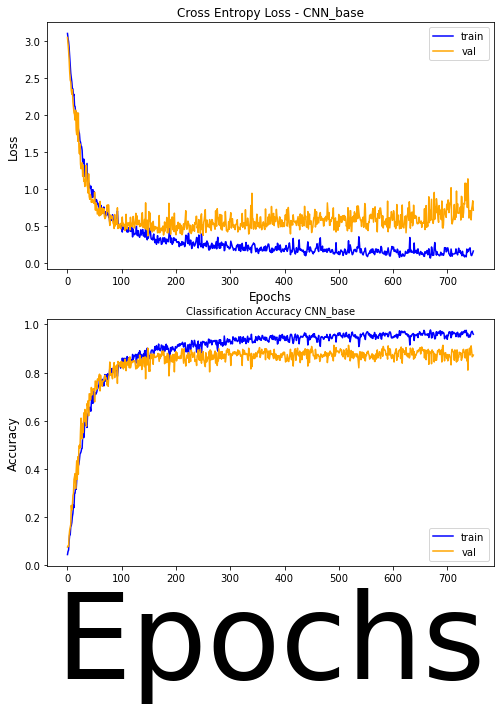

In [23]:
history_plot('CNN_base', history)

#### Saving our model to disk

A Keras model consists of multiple components:

+ An architecture, or configuration, which specifies what layers the model contain, and how they're connected.
+ A set of weights values (the "state of the model").
+ An optimizer (defined by compiling the model).
+ A set of losses and metrics (defined by compiling the model or calling add_loss() or add_metric()).
The Keras API makes it possible to save all of these pieces to disk at once, or to only selectively save some of them:

+ Saving everything into a single archive in the TensorFlow SavedModel format (or in the older Keras H5 format). This is the standard practice.
+ Saving the architecture / configuration only, typically as a JSON file.
+ Saving the weights values only. This is generally used when training the model.

In [24]:
saved_model = load_model(checkpoint_best_model)

from datetime import datetime
DTime = datetime.now().strftime('%Y%m%d_%H%M%S')

_, acc = saved_model.evaluate(X_train, y_train, verbose=0)
print('Model evaluate on train, Accuracy %.3f' % (acc * 100.0))
_, acc = saved_model.evaluate(X_val, y_val, verbose=0)
print('Model evaluate on val, Accuracy %.3f' % (acc * 100.0))
_, acc = saved_model.evaluate(X_test, y_test, verbose=0)
print('Model evaluate on test, Accuracy %.3f' % (acc * 100.0))
acc_test = round(100*acc,2)

save_file = checkpoint_best_model[0:-5] +'_' + DTime + '_ACC' + str(acc_test)+'.h5'
print("Model saved: ", save_file)
saved_model.save(save_file,  save_format="h5")

Model evaluate on train, Accuracy 99.603
Model evaluate on val, Accuracy 90.952
Model evaluate on test, Accuracy 86.190
Model saved:  model/MultiClass_3Conv2Den_dataAugm_20210209_044447_ACC86.19.h5


# 5. Prediction on test image

In [25]:
# load the weights form the best epoch
model = saved_model
test_gen = image_gen_test.flow(np.array(X_test),
                              batch_size = batch_size,
                              shuffle = False)
STEP_SIZE_TEST = X_test.shape[0] // batch_size
print('predicting...')
predictions = model.predict(test_gen, 
                            steps = STEP_SIZE_TEST+1)

# convert predictions    
print('num. predictions: ', len(predictions))

predicting...
num. predictions:  420


In [26]:
y_pred = to_categorical(np.argmax(predictions, axis=1), nb_classes)

In [27]:
# classification report
report_string = classification_report(y_test, y_pred, target_names=category_names)
print(report_string)

                   precision    recall  f1-score   support

     agricultural       0.86      0.95      0.90        20
         airplane       0.90      0.95      0.93        20
  baseballdiamond       0.89      0.85      0.87        20
            beach       1.00      1.00      1.00        20
        buildings       0.58      0.90      0.71        20
        chaparral       0.95      0.95      0.95        20
 denseresidential       0.64      0.45      0.53        20
           forest       1.00      0.90      0.95        20
          freeway       0.90      0.95      0.93        20
       golfcourse       0.89      0.80      0.84        20
           harbor       0.95      0.95      0.95        20
     intersection       0.90      0.95      0.93        20
mediumresidential       0.75      0.90      0.82        20
   mobilehomepark       0.85      0.85      0.85        20
         overpass       0.95      0.90      0.92        20
       parkinglot       1.00      0.95      0.97       

In [28]:
# Confusion matrix
confmat = confusion_matrix( y_test.argmax(axis=1), predictions.argmax(axis=1))
confmat

array([[19,  0,  0,  0,  0,  0,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0],
       [ 0, 19,  0,  0,  0,  0,  0,  0,  0,  0,  1,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0],
       [ 0,  0, 17,  0,  0,  0,  0,  0,  0,  1,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  2],
       [ 0,  0,  0, 20,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0],
       [ 0,  0,  0,  0, 18,  0,  2,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0],
       [ 1,  0,  0,  0,  0, 19,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0],
       [ 0,  0,  0,  0,  6,  0,  9,  0,  0,  0,  0,  1,  2,  2,  0,  0,
         0,  0,  0,  0,  0],
       [ 1,  0,  0,  0,  0,  1,  0, 18,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0],
       [ 0,  0,  1,  0,  0,  0,  0,  0, 19,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0],
       [ 1,  0,  1,  0,  0,  0,  0,  0,  0, 16,  0,  0,  0,  0,  0,  0,
         0,  0,  1,

In [29]:
def plot_cm(y_true, y_pred, figsize=(12,10)):
    cm = confusion_matrix(y_true, y_pred, labels=np.unique(y_true))
    cm_sum = np.sum(cm, axis=1, keepdims=True)
    cm_perc = cm / cm_sum.astype(float) * 100
    annot = np.empty_like(cm).astype(str)
    nrows, ncols = cm.shape
    for i in range(nrows):
        for j in range(ncols):
            c = cm[i, j]
            p = cm_perc[i, j]
            if i == j:
                s = cm_sum[i]
                annot[i, j] = '%d/%d' % (c, s)
            elif c == 0:
                annot[i, j] = ''
            elif i<j:
                annot[i, j] = '%d' % (c)
            else:
                annot[i, j] = '%d' % (c)
    #cm = pd.DataFrame(cm, index=np.unique(y_true), columns=np.unique(y_true))
    cm = pd.DataFrame(cm, index=category_names, columns=category_names)
    cm.index.name = 'Actual'
    cm.columns.name = 'Predicted'
    fig, ax = plt.subplots(figsize=figsize)
    sns.set(font_scale=1.4)
    sns.heatmap(cm, cmap= "YlGnBu", annot=annot, fmt='', ax=ax, annot_kws={"fontsize":12})
    
    

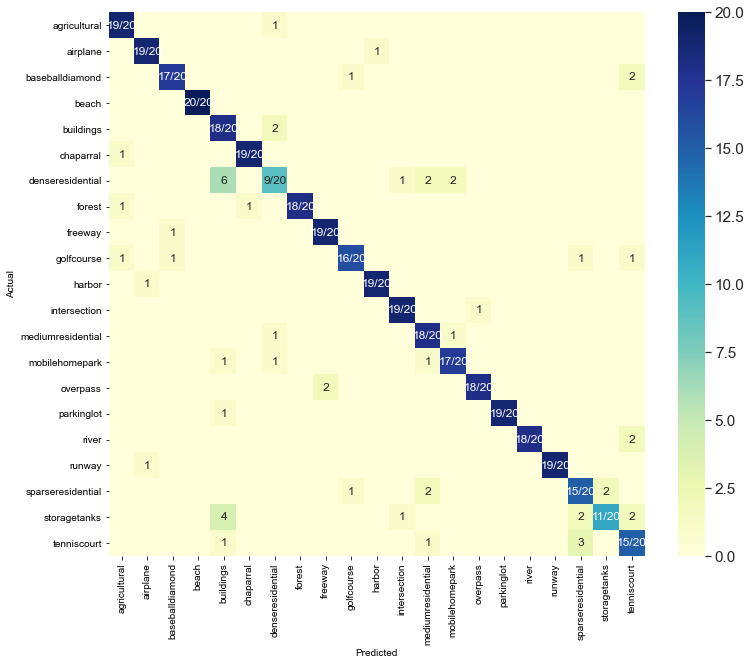

In [30]:
plot_cm( y_test.argmax(axis=1), predictions.argmax(axis=1))

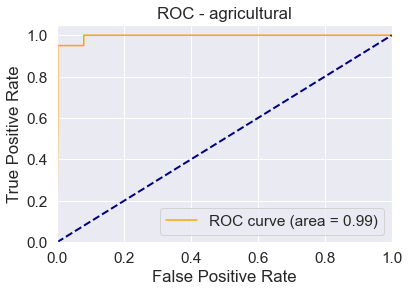

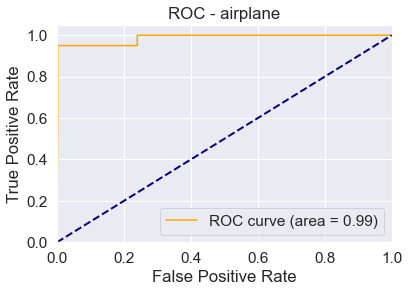

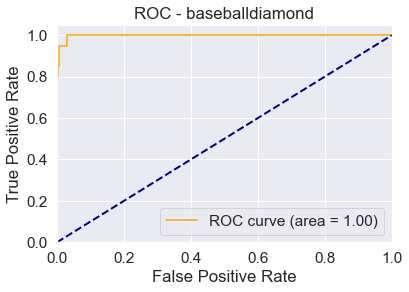

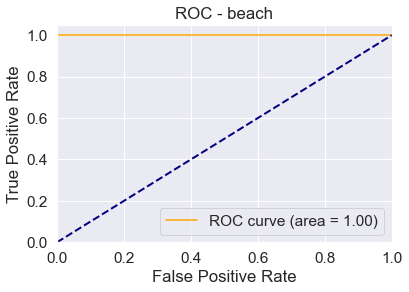

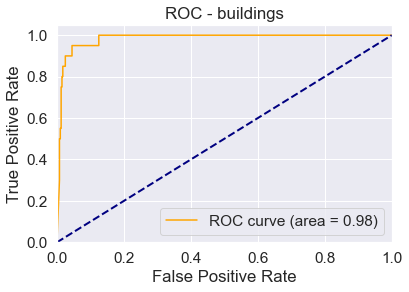

...

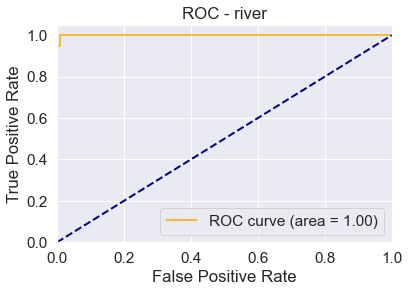

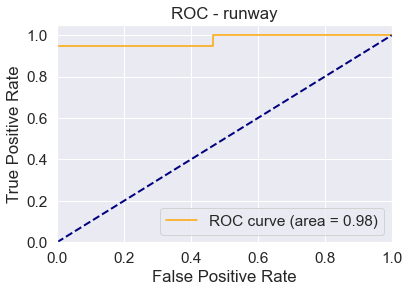

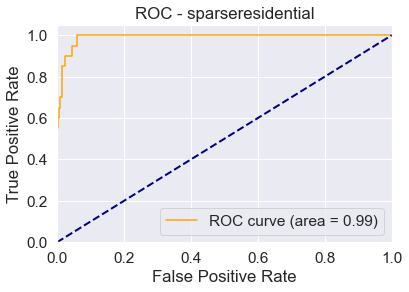

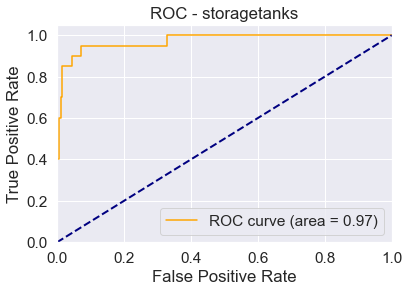

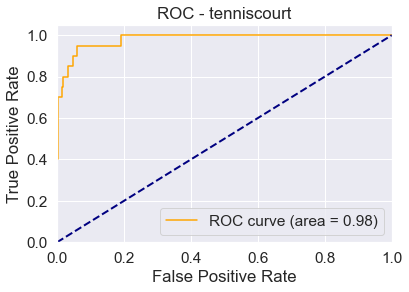

In [31]:
from sklearn.multiclass import OneVsRestClassifier
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc

y_score = model.predict(X_test)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(nb_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot of a ROC curve for a specific class
for i in range(nb_classes):
    plt.figure()
    plt.plot(fpr[i], tpr[i], color='orange', label='ROC curve (area = %0.2f)' % roc_auc[i])
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC - '+ category_names[i])
    plt.legend(loc="lower right")
    plt.show()

In [32]:
# VISUALIZE IMAGES

import math

def plotImages_categories( images, labels, predictions, n_cols=4, figsize=(10, 10)):
    fig, axes = plt.subplots(math.ceil(len(images)/n_cols), n_cols, figsize=figsize)
    axes = axes.flatten()
    for i in range(math.ceil(len(images)/n_cols) * n_cols):
        axes[i].set_xticks(())
        axes[i].set_yticks(())
        
        if i < len(images):
            axes[i].imshow(images[i])
            if predictions is not None:
                title = 'LABEL:{}\nPRED: {}'.format(labels[i], predictions[i])

                if predictions[i] != labels[i]:
                    [j.set_linewidth(5) for j in axes[i].spines.values()]
                    [j.set_color('red') for j in axes[i].spines.values()]

            else:
                title = 'LABEL:{}'.format(labels[i])
            axes[i].set_title(title, fontdict={'family':'monospace'}, loc='left',fontsize = 12)
    plt.tight_layout()
    plt.show()


Category:agricultural, Total Samples:20


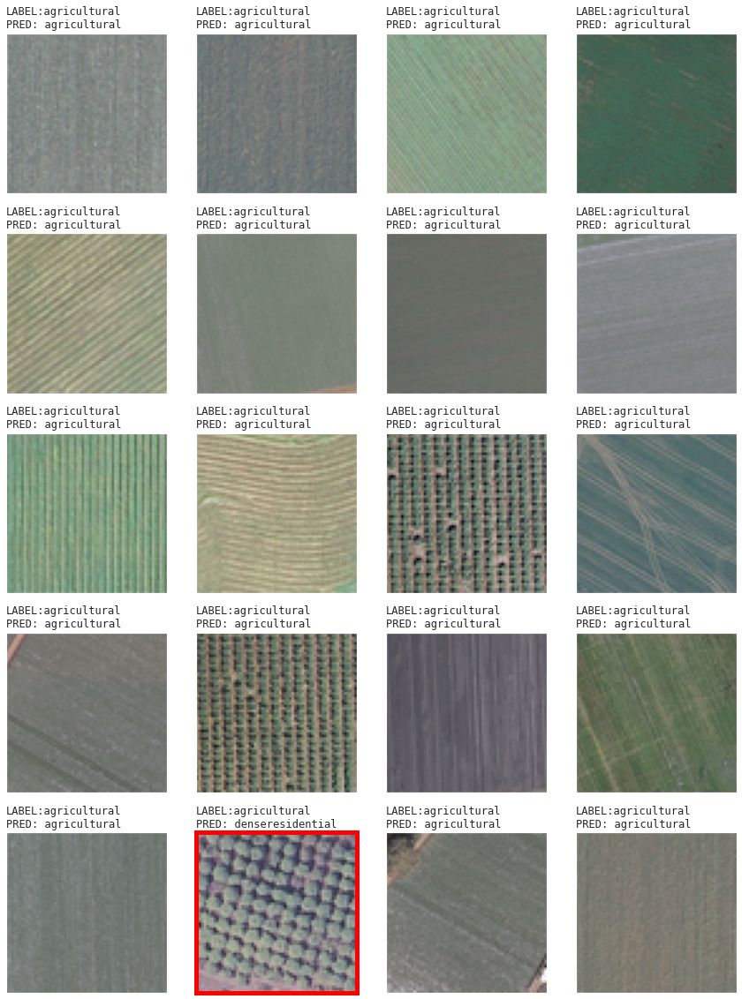


Category:airplane, Total Samples:20


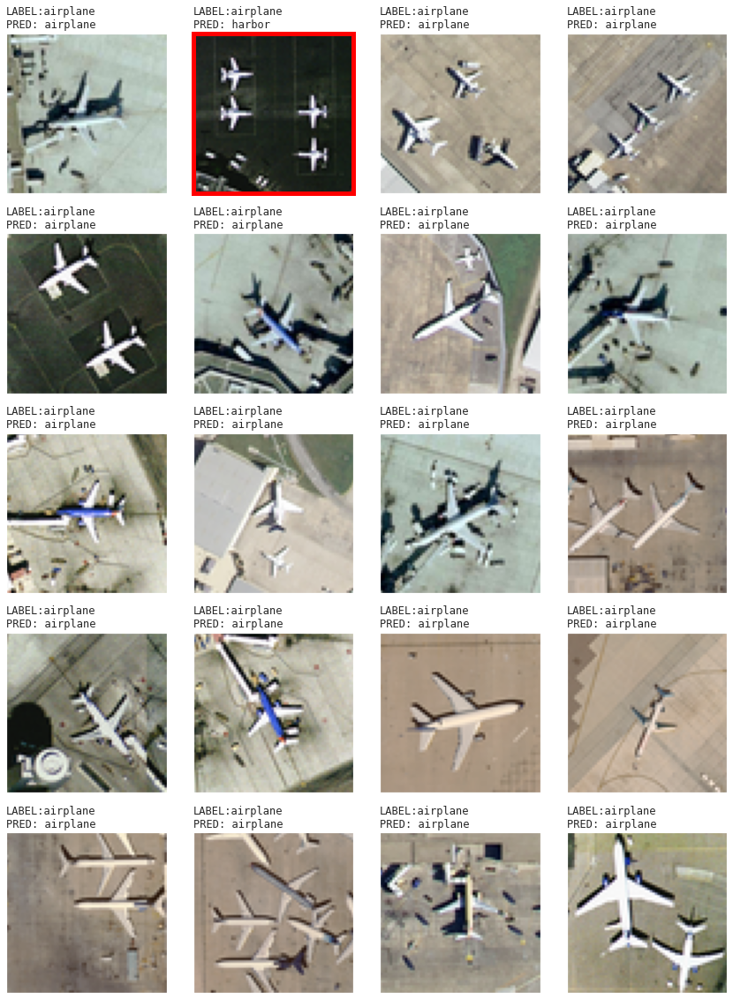


Category:baseballdiamond, Total Samples:20


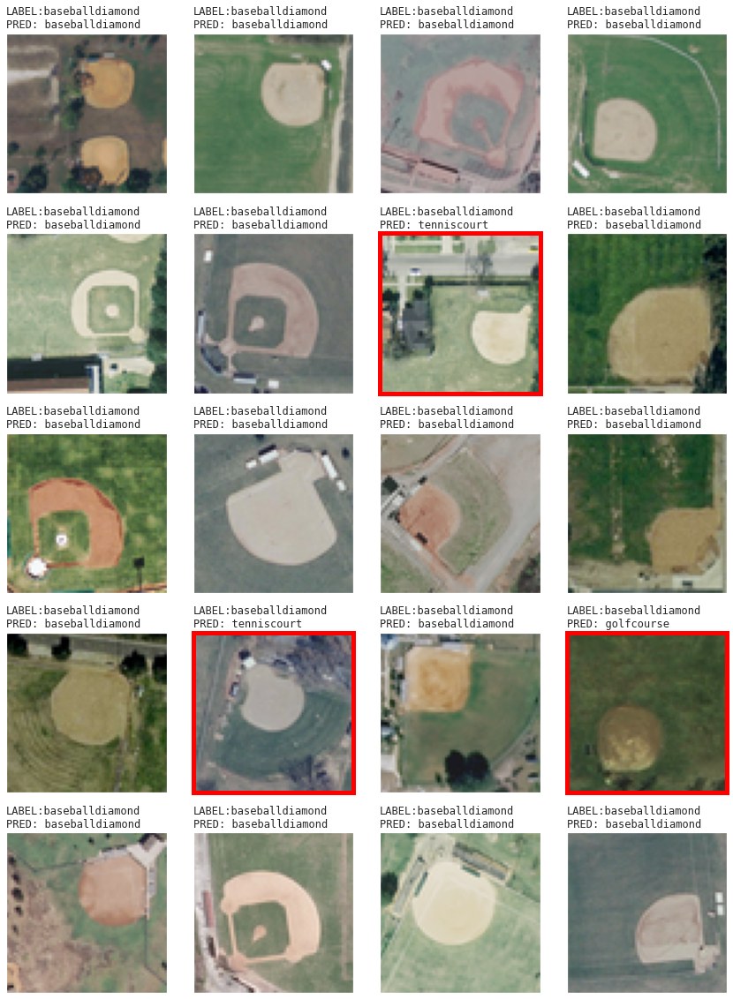


Category:beach, Total Samples:20


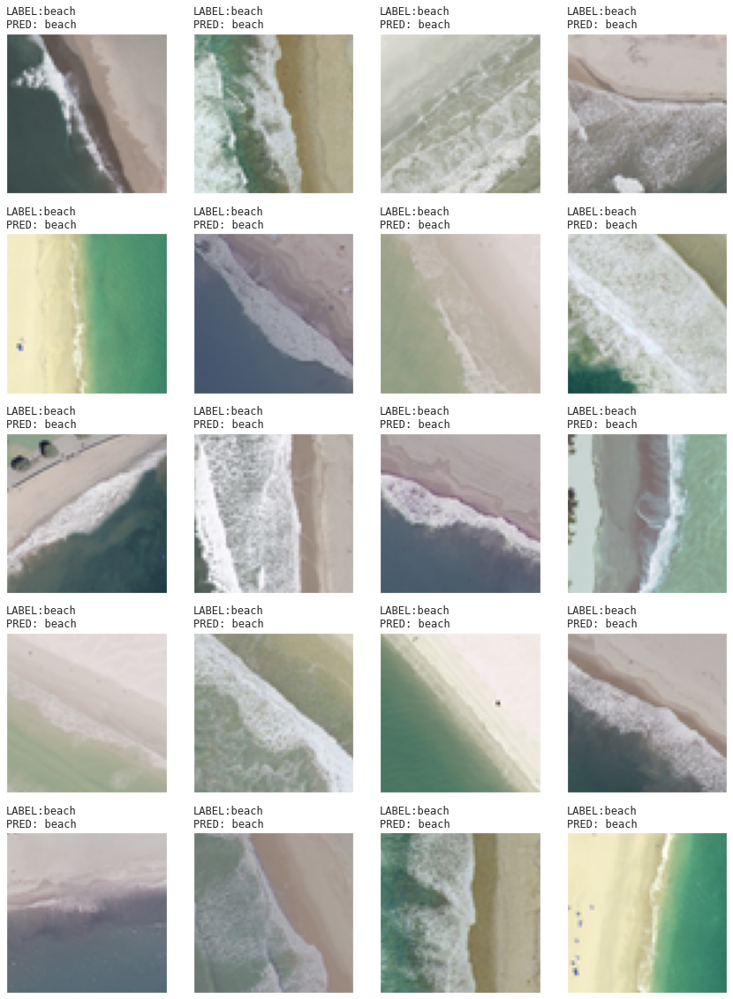


Category:buildings, Total Samples:20


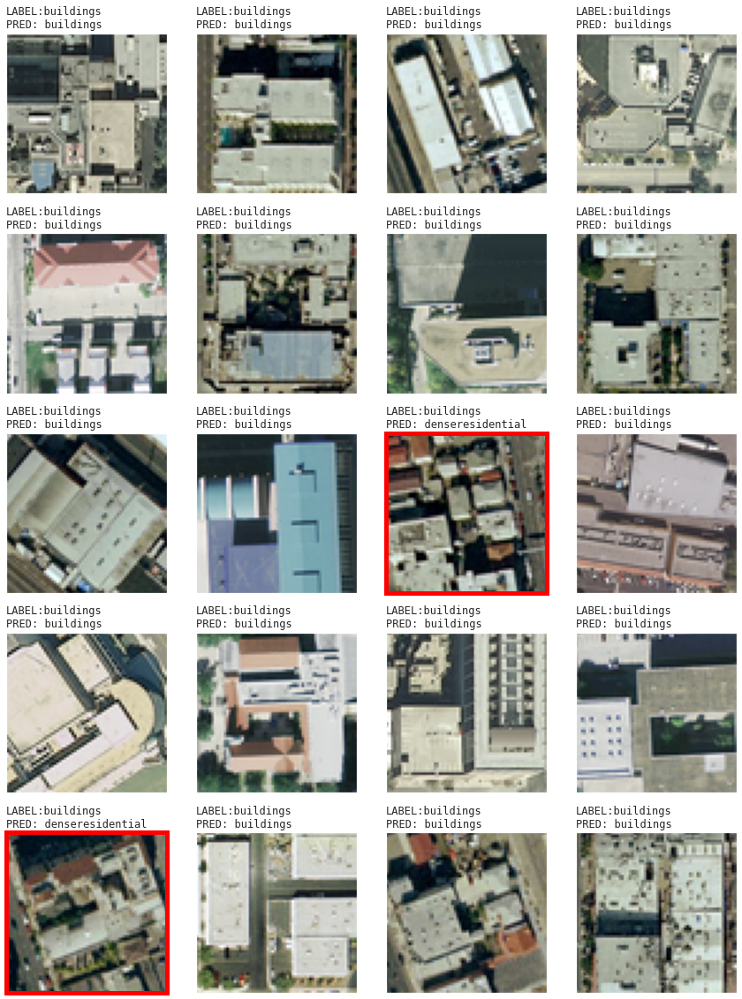


Category:chaparral, Total Samples:20


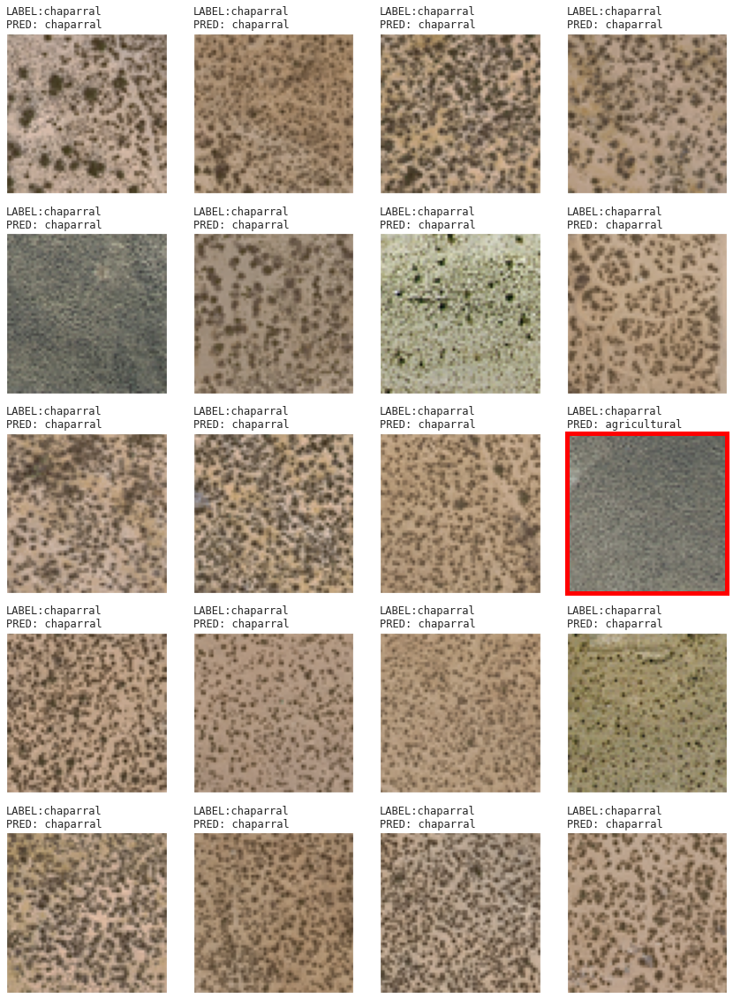


Category:denseresidential, Total Samples:20


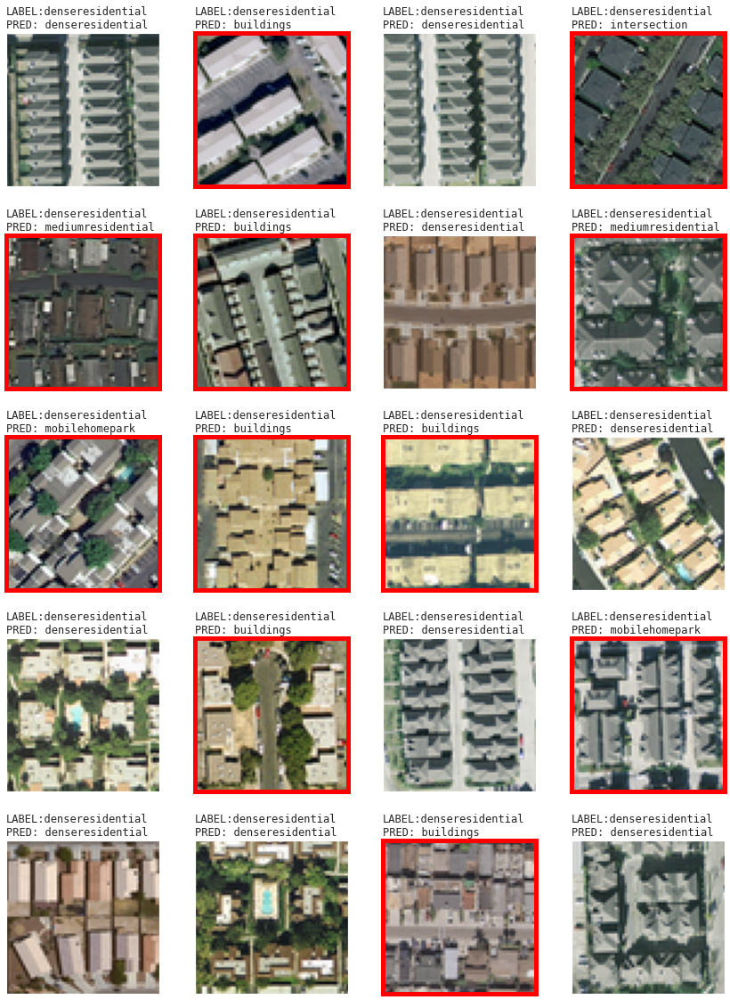


Category:forest, Total Samples:20


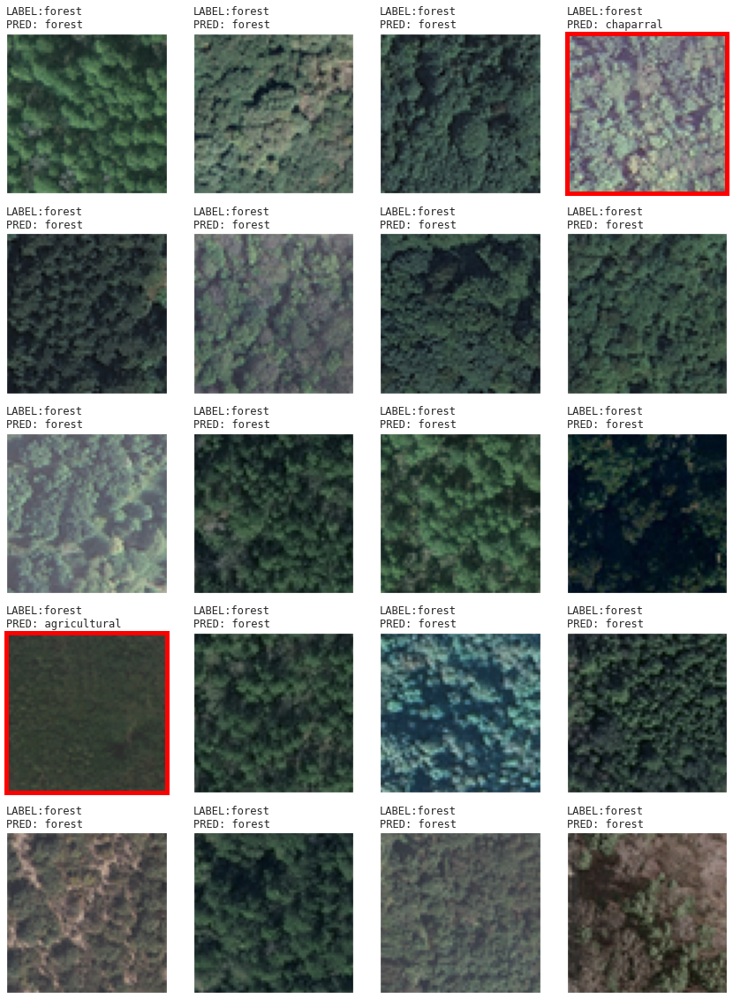


Category:freeway, Total Samples:20


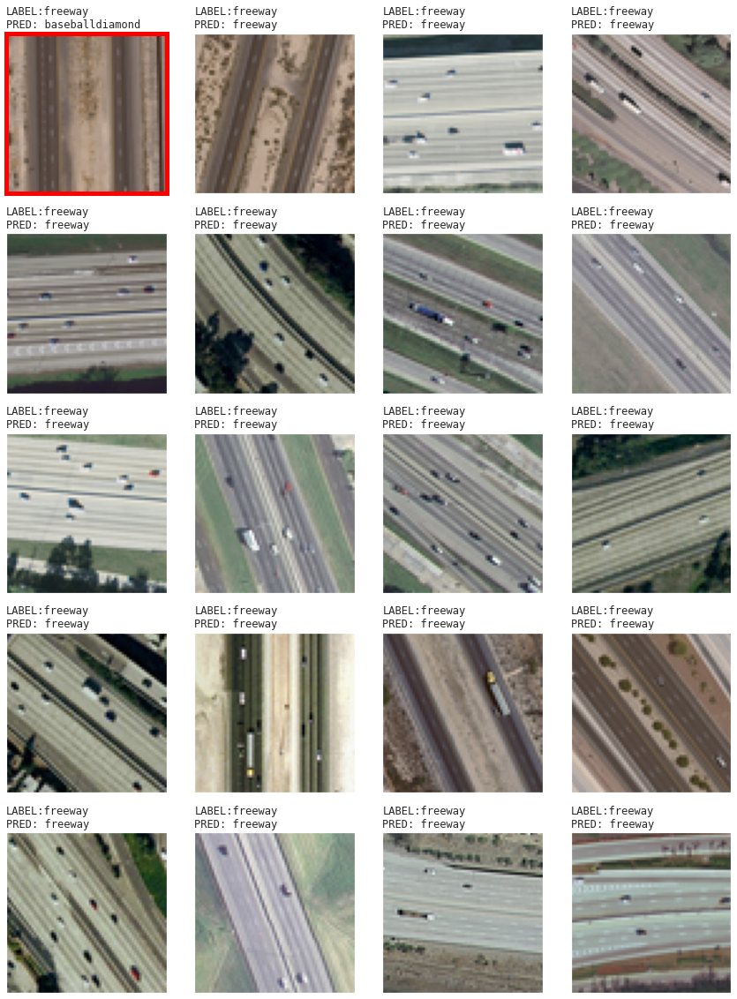


Category:golfcourse, Total Samples:20


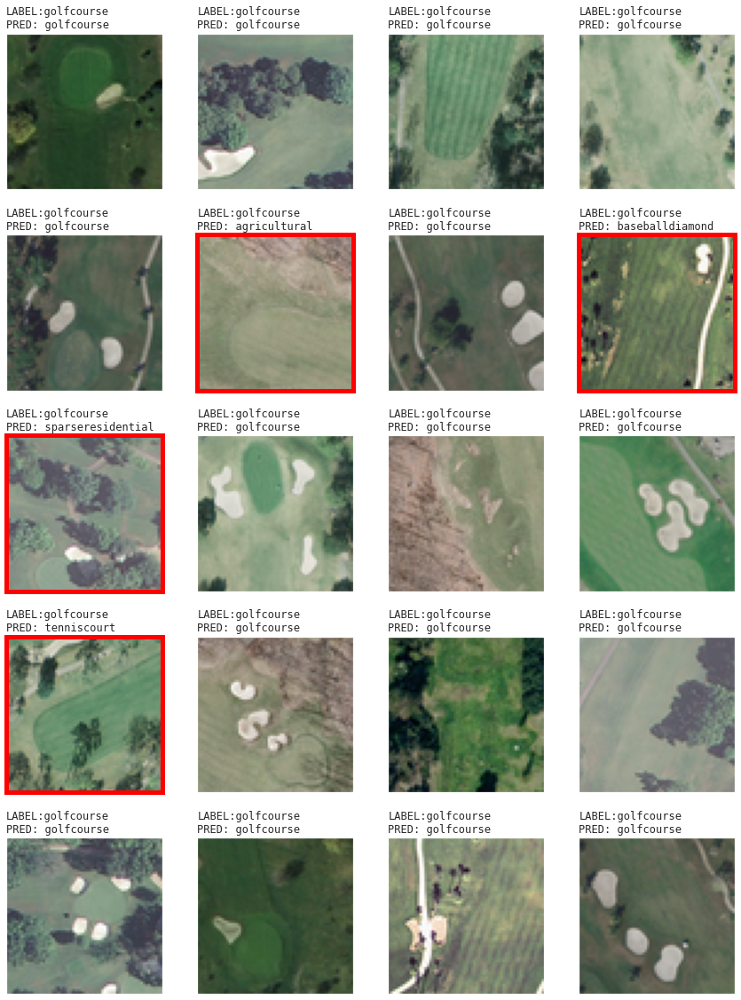


Category:harbor, Total Samples:20


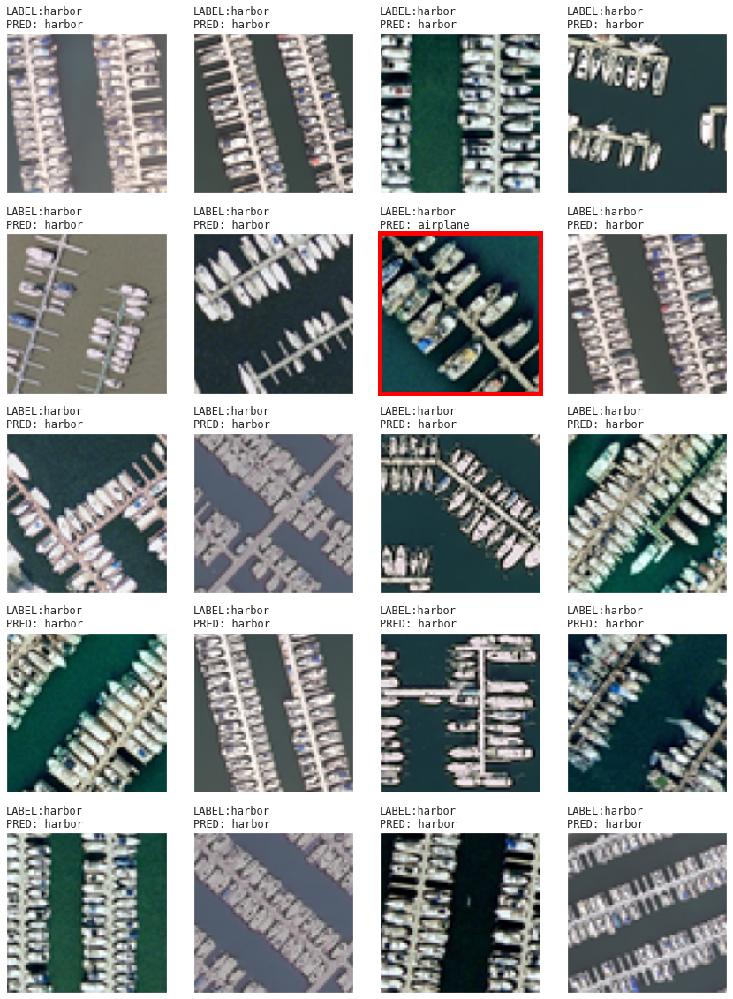


Category:intersection, Total Samples:20


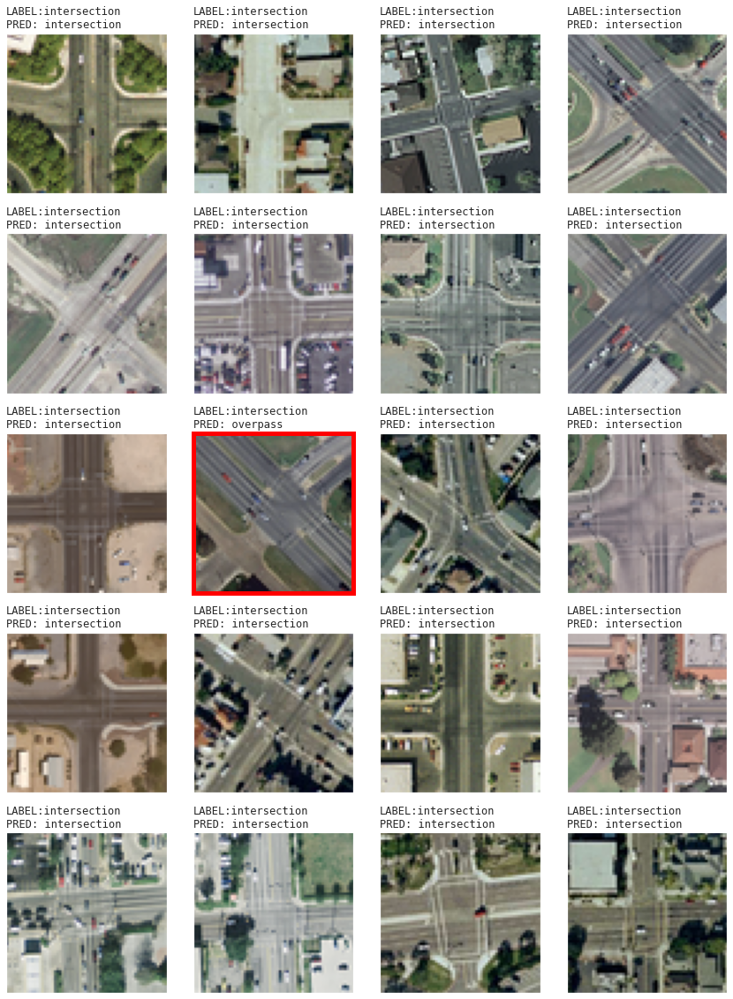


Category:mediumresidential, Total Samples:20


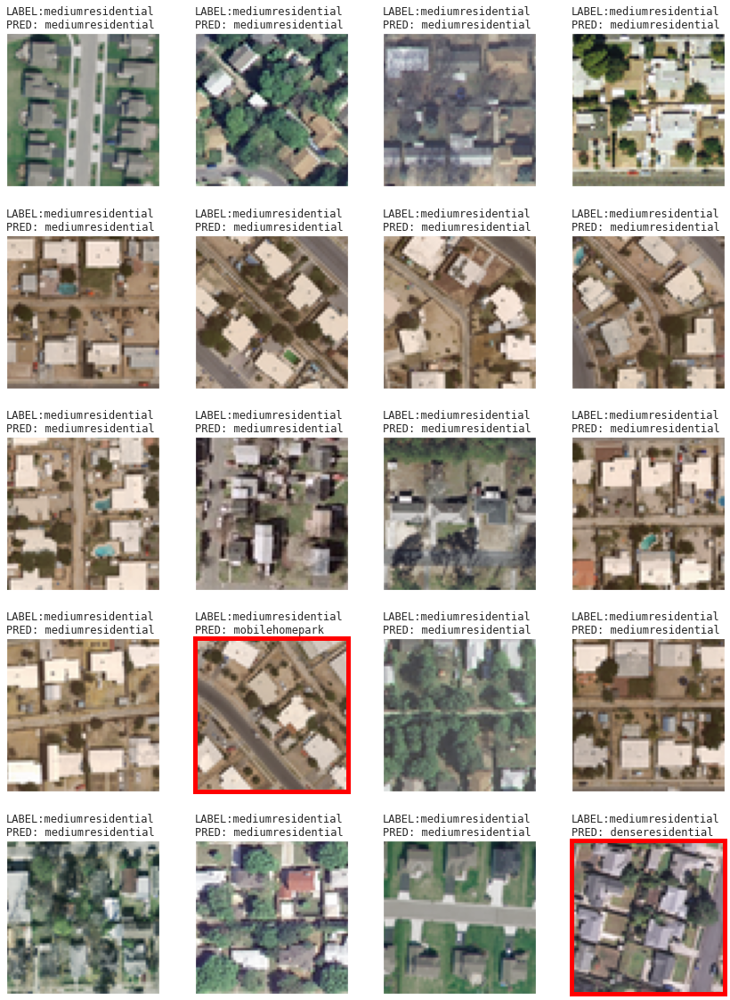


Category:mobilehomepark, Total Samples:20


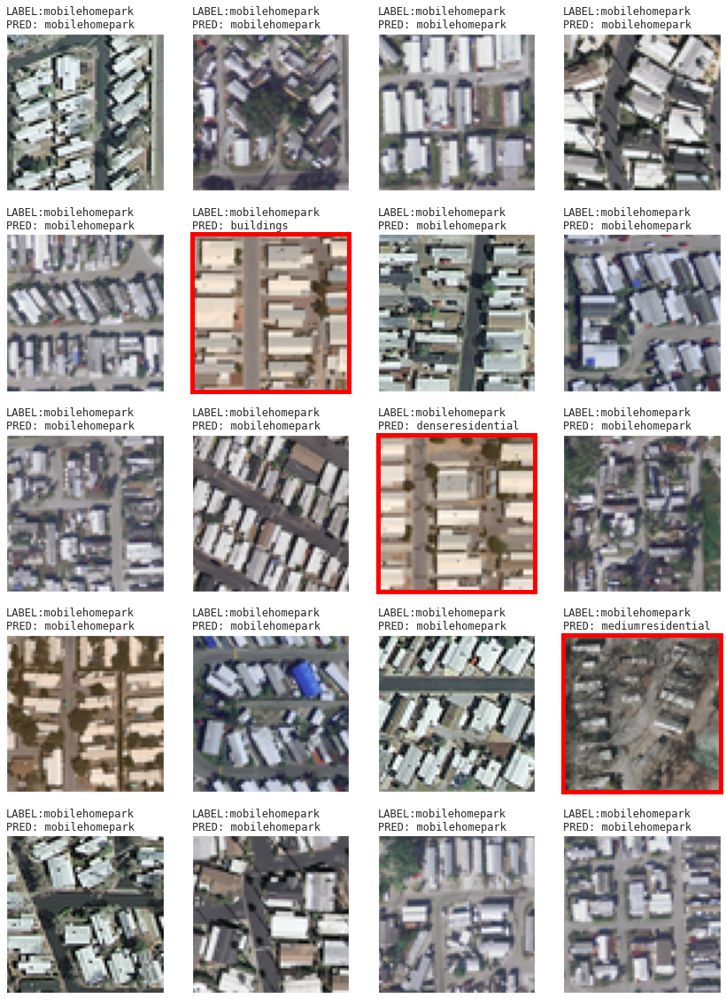


Category:overpass, Total Samples:20


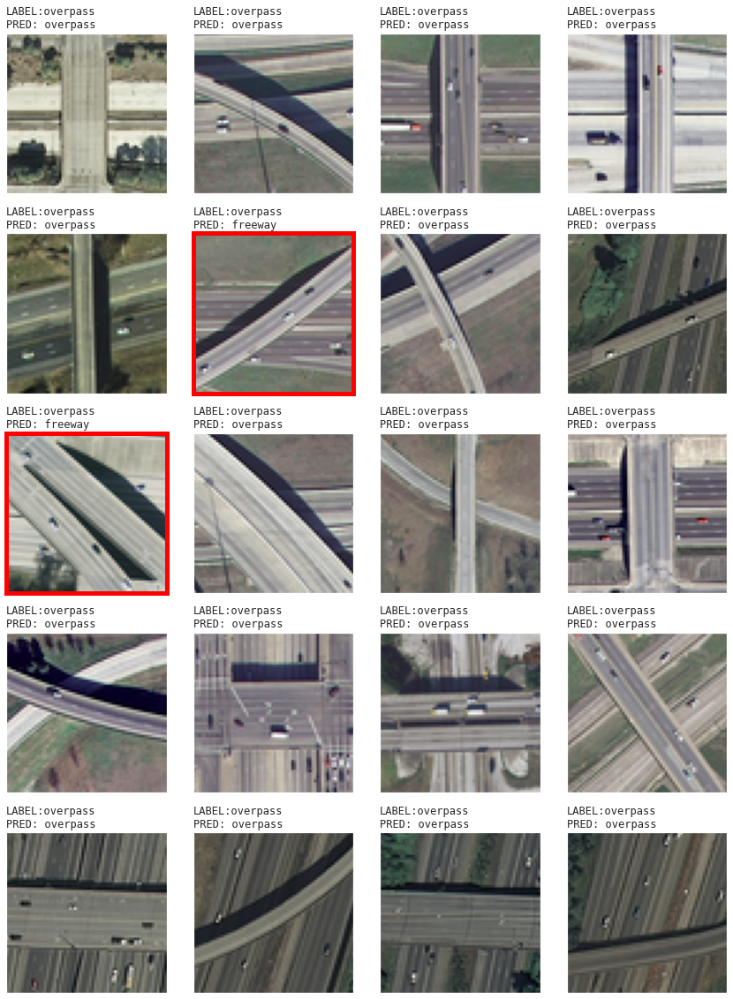


Category:parkinglot, Total Samples:20


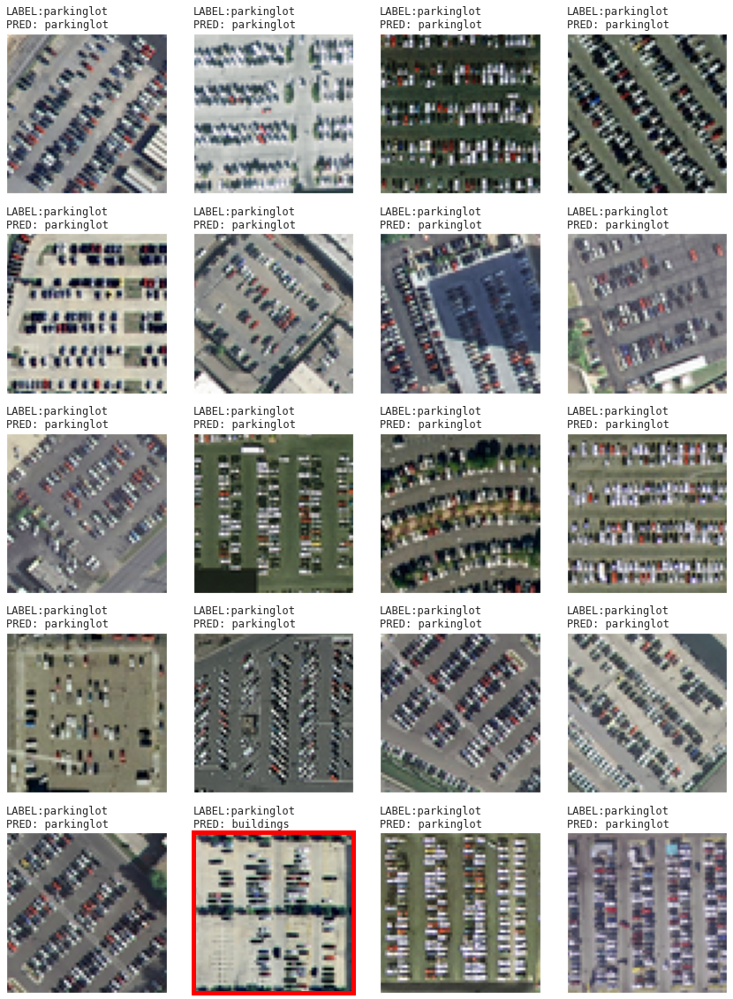


Category:river, Total Samples:20


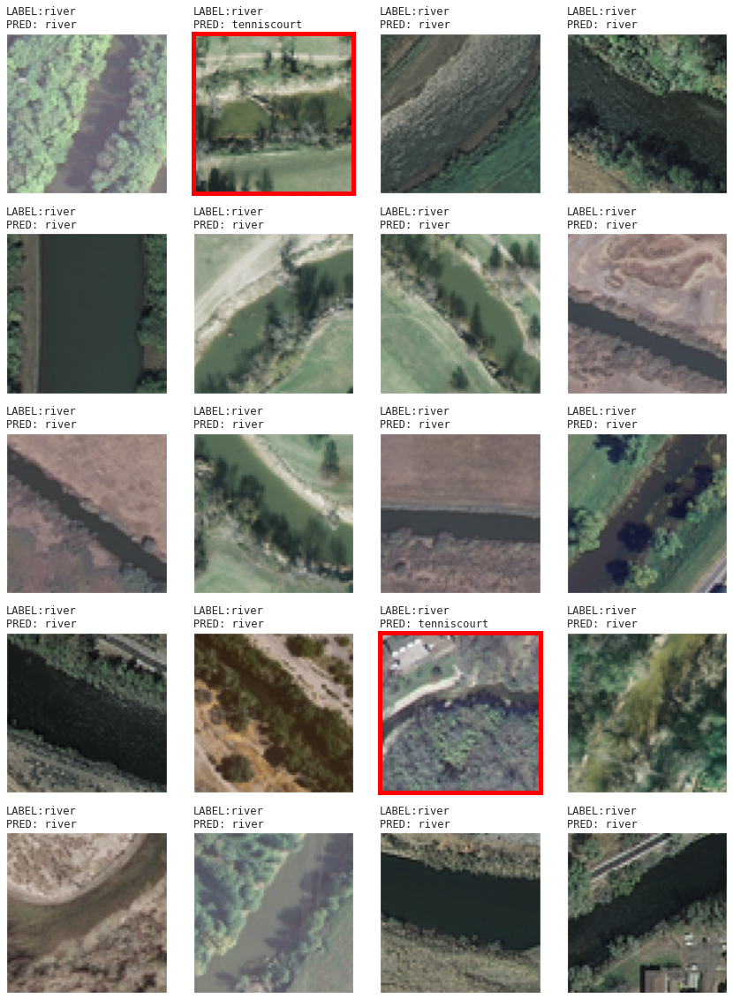


Category:runway, Total Samples:20


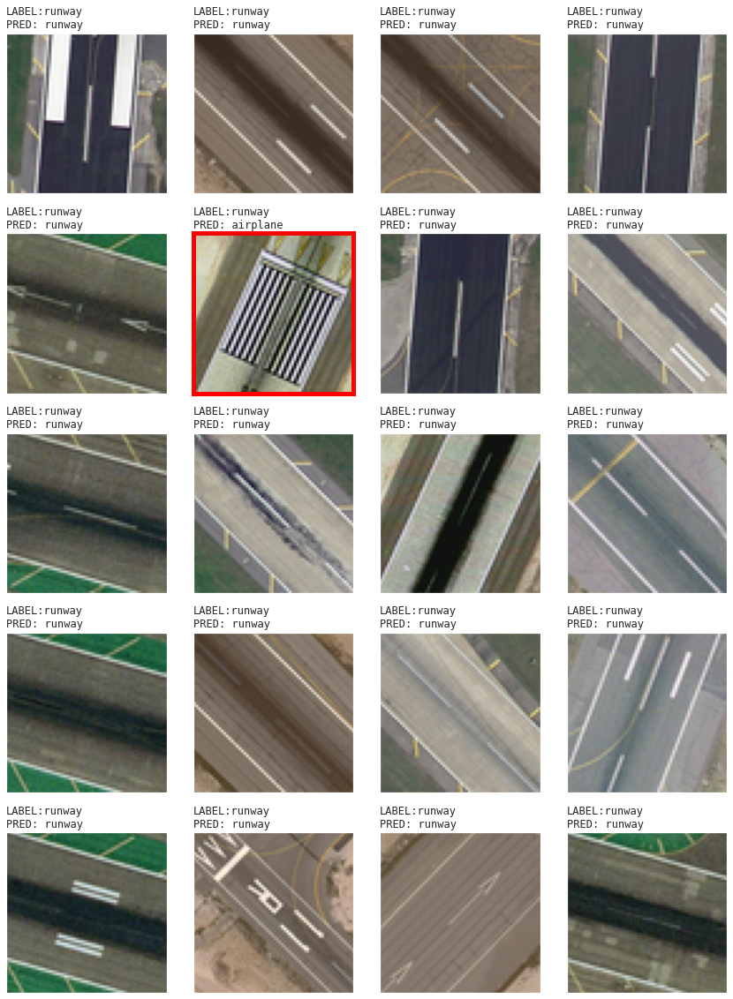


Category:sparseresidential, Total Samples:20


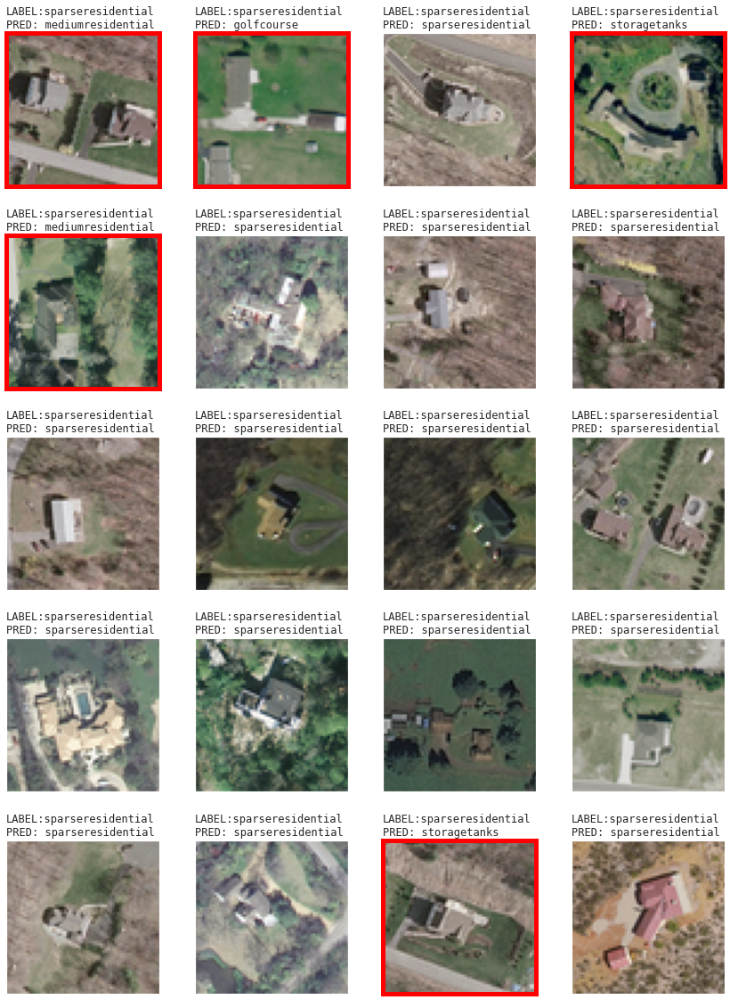


Category:storagetanks, Total Samples:20


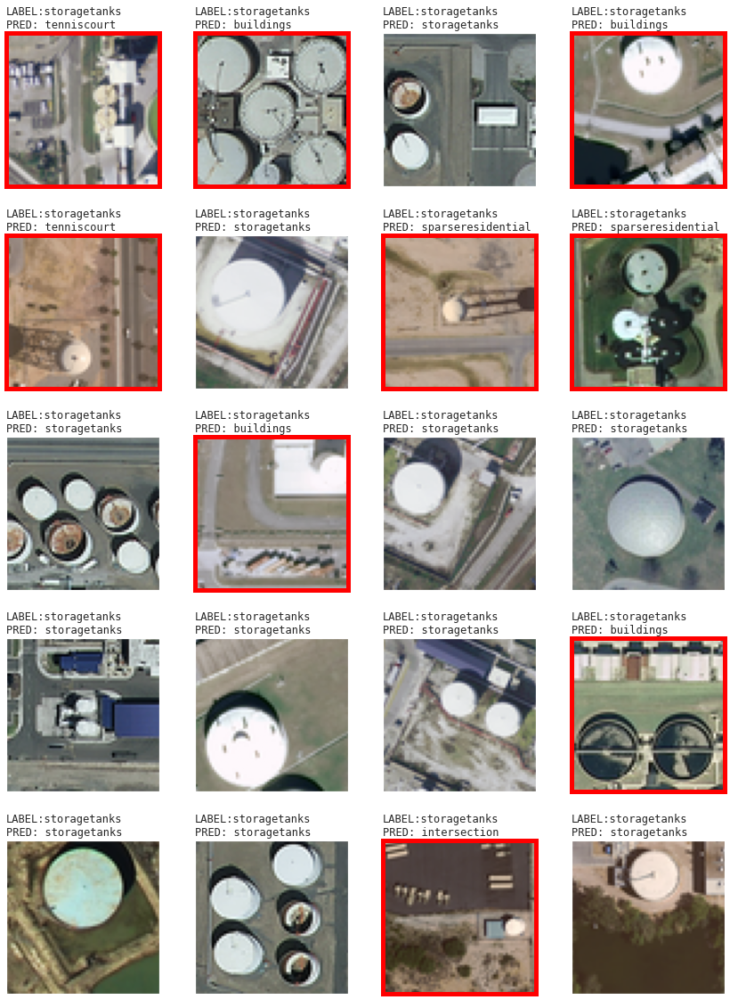


Category:tenniscourt, Total Samples:20


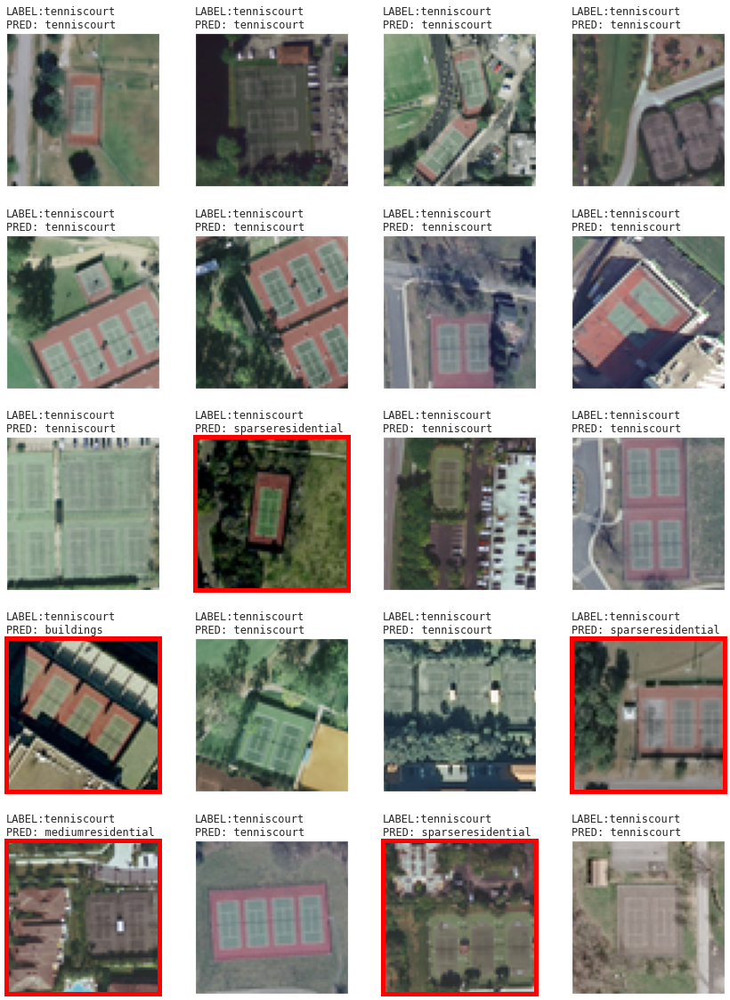

In [33]:
for i in range(len(category_names)):
    cat = []
    cat_pred = []
    X_test_cat = []
    for j in range(len(y_test)):
        if y_test.argmax(axis=1)[j] == i:
            cat.append(category_names[i])
            cat_pred.append(category_names[predictions.argmax(axis=1)[j]])
            X_test_cat.append(X_test[j])
    
    print('\nCategory:{}, Total Samples:{}'.format(category_names[i], len(cat)))
    
    plotImages_categories(images=X_test_cat, labels=cat,
                          predictions=cat_pred, 
                        figsize=(12, 16))